In [1]:
from dataset.protocol import Protocol
from dataset.data_loaders import Patch_Classifier_Dataset

mk = Protocol("C:/Users/b_charmettant/data/immuno/", 'MK1454')

In [2]:
from torchvision.transforms import Compose, RandomHorizontalFlip, RandomVerticalFlip, ColorJitter, RandomAffine
from utils.augmentation import Rotate_90
from torch.utils.data import DataLoader

transformations = Compose([RandomHorizontalFlip(p=0.5), 
                           RandomVerticalFlip(p=0.5), 
                           Rotate_90(),
                           ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0),
                           RandomAffine(10, translate=None, scale=(1,1.2), shear=None)
                        ])

resize = 224


train_dataset = Patch_Classifier_Dataset([mk], 0.4,
                                         resize=resize,
                                         transform=transformations,
                                         subset=None,
                                         experiment="exp_3",
                                         black_white=True)


train_loader = DataLoader(train_dataset, batch_size=1, shuffle=False)

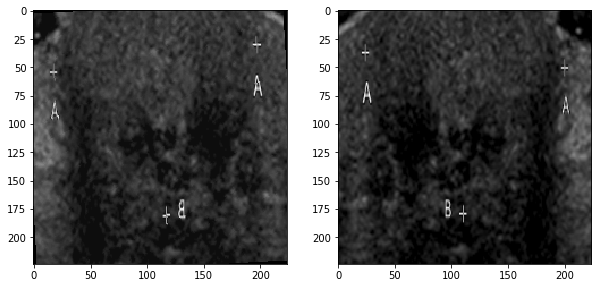

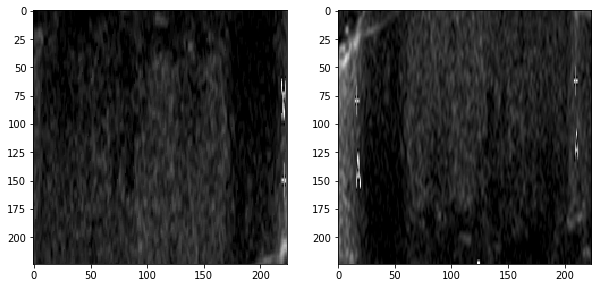

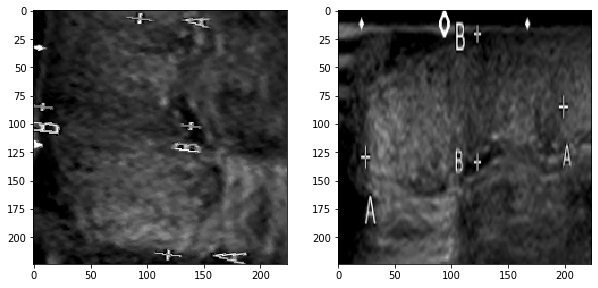

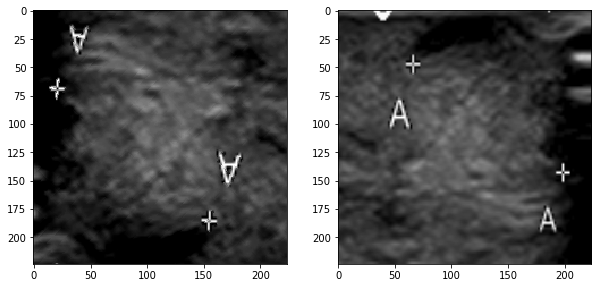

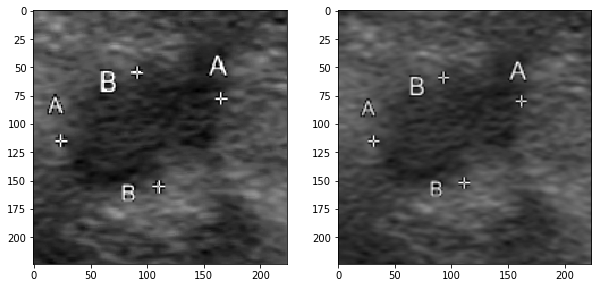

...

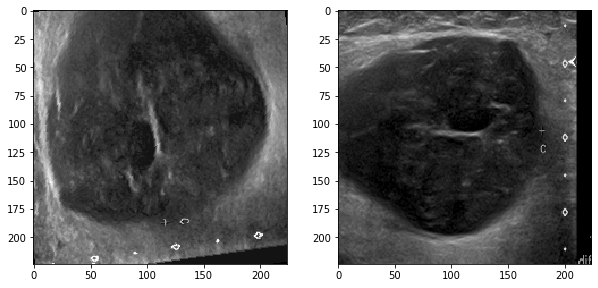

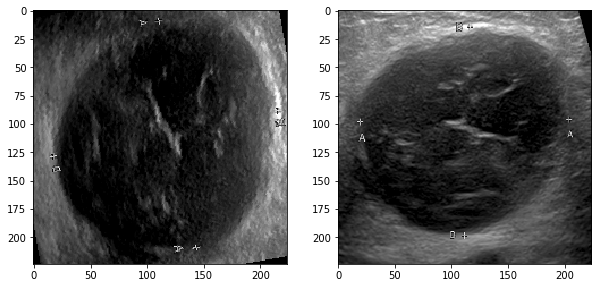

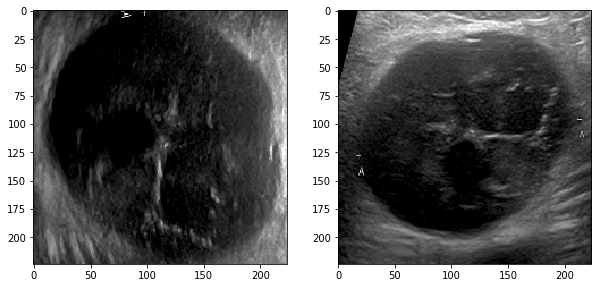

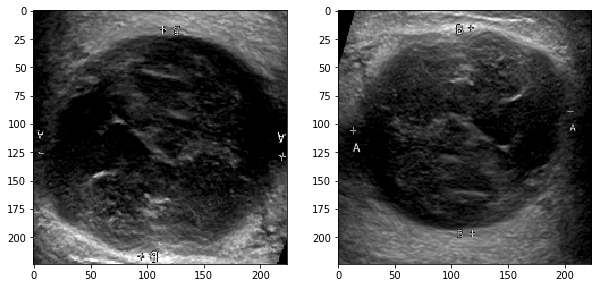

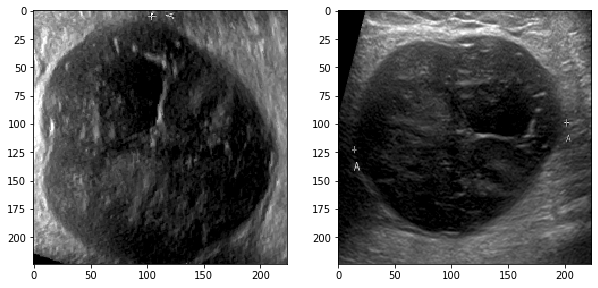

In [6]:
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = [10, 5]

i = 0
for patch, label in train_loader:
    patch = patch.cpu().numpy().reshape(resize, resize)
    
    original = train_dataset.patches[i].reshape(resize, resize)
    
    fig, axis = plt.subplots(1, 2)
    
    axis[0].imshow(patch, cmap='gray')
    axis[1].imshow(original, cmap='gray')
    plt.show()
    
    i=i+1